In [1]:
import time
# Start the timer
start_time1 = time.time()

In [2]:
import tensorflow as tf
import tensorflow_hub as hub
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.layers.experimental.preprocessing import RandomFlip, RandomRotation
from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
import numpy as np
from tensorflow.keras import layers, models
from tensorflow.keras.applications.mobilenet import preprocess_input as mobilenet_preprocess_input
from tensorflow.keras.applications.inception_v3 import preprocess_input as inception_preprocess_input
import datetime


%load_ext tensorboard

In [3]:
# define the value for the image size, batch size and epoch
MOB_IMG_SIZE = (224, 224)
MOB_INPUT_SHAPE = (224, 224, 3)
BATCH_SIZE = 32
EPOCHS = 50
NUM_CLASSES = 8
VAL_SPLIT = 0.30
SEED = 123

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
# load the image data

img_data = '/content/drive/MyDrive/Image_classification/engineering_tools'

In [6]:
# Load datasets using the image_dataset_from_directory
train_dataset_mobilenet = tf.keras.utils.image_dataset_from_directory(
    img_data,
    labels='inferred',
    label_mode='categorical',
    validation_split=VAL_SPLIT,
    subset="training",
    seed=SEED,
    image_size=MOB_IMG_SIZE,
    batch_size=BATCH_SIZE)

validation_dataset_mobilenet = tf.keras.utils.image_dataset_from_directory(
    img_data,
    labels='inferred',
    label_mode='categorical',
    validation_split=VAL_SPLIT,
    subset="validation",
    seed=SEED,
    image_size=MOB_IMG_SIZE,
    batch_size=BATCH_SIZE)


Found 678 files belonging to 8 classes.
Using 475 files for training.
Found 678 files belonging to 8 classes.
Using 203 files for validation.


In [7]:
# define a function to plot the images with their corresponding labels
def plot_images_with_labels(images, labels, class_names, num_images=15, columns=5):
    rows = num_images // columns
    plt.figure(figsize=(15, 9))
    for i in range(num_images):
        ax = plt.subplot(rows, columns, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        label_index = np.argmax(labels[i].numpy())
        label = class_names[label_index]
        plt.title(label)
        plt.axis("off")
    plt.show()

class_names = train_dataset_mobilenet.class_names
class_names

['chisel',
 'hammer',
 'level',
 'measuring_tape',
 'plier',
 'saw',
 'screw_driver',
 'wrench']

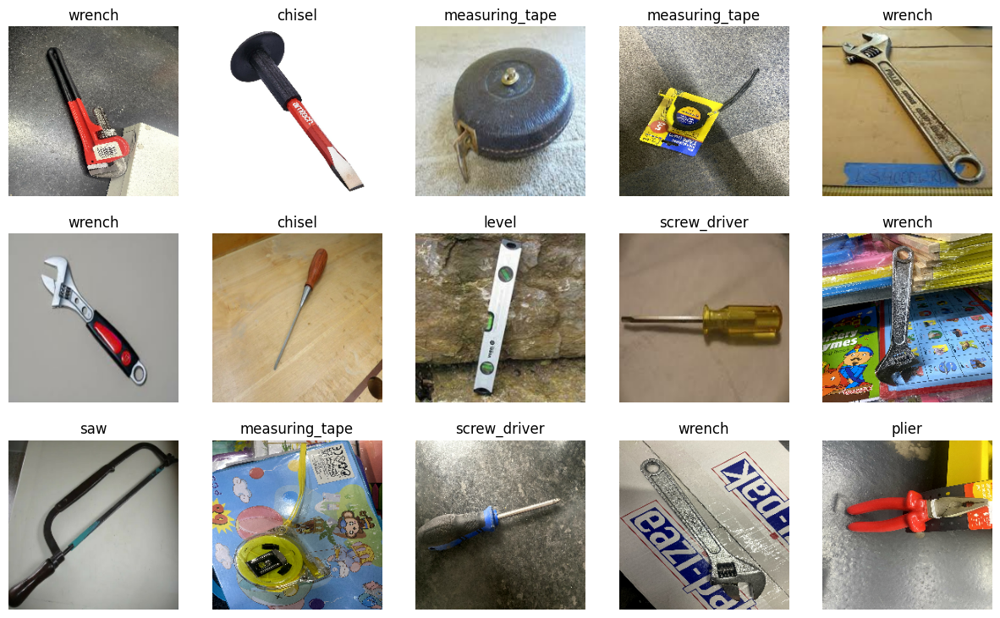

In [8]:
# Display images from the training dataset
for images, labels in train_dataset_mobilenet.take(1):
    plot_images_with_labels(images, labels, class_names, num_images=15, columns=5)


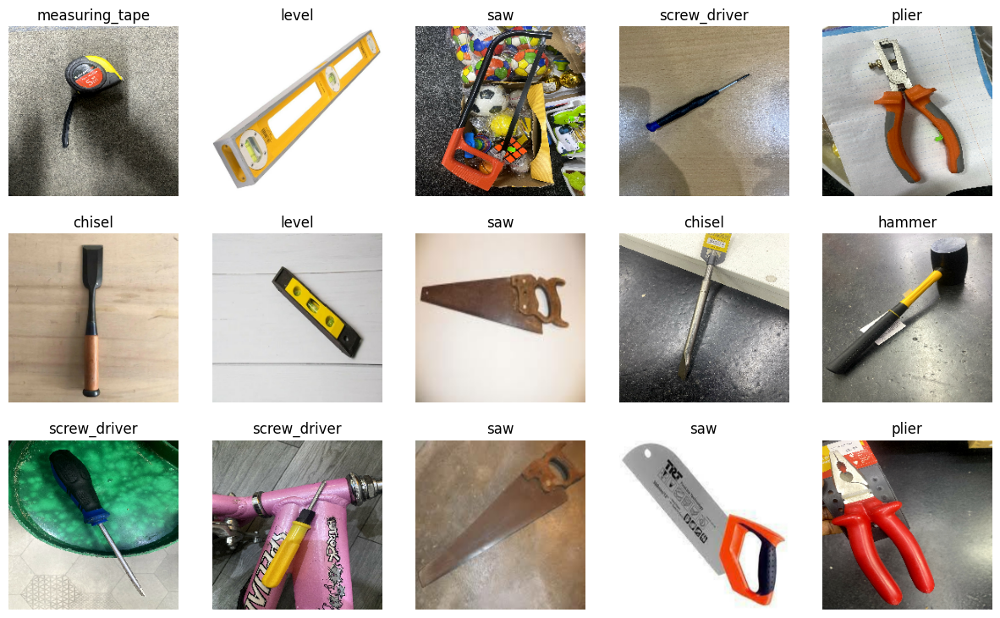

In [9]:
# Display images from the validation dataset
for images, labels in validation_dataset_mobilenet.take(1):
    plot_images_with_labels(images, labels, class_names, num_images=15, columns=5)

In [10]:
val_batches_mobilenet = tf.data.experimental.cardinality(validation_dataset_mobilenet)
num_test_mob_batches = val_batches_mobilenet // 3 + 1
test_dataset_mobilenet = validation_dataset_mobilenet.take(num_test_mob_batches)  # Ensure at least one batch for testing
validation_dataset_mobilenet = validation_dataset_mobilenet.skip(num_test_mob_batches)  # Skip the batch taken for testing

print('Number of validation batches:', tf.data.experimental.cardinality(validation_dataset_mobilenet).numpy())
print('Number of test batches:', tf.data.experimental.cardinality(test_dataset_mobilenet).numpy())


Number of validation batches: 4
Number of test batches: 3


In [11]:
# Calculate the number of batches in the validation and test datasets
val_batches_mobilenet = tf.data.experimental.cardinality(validation_dataset_mobilenet)
test_batches_mobilenet = tf.data.experimental.cardinality(test_dataset_mobilenet)

# calculate the number of images
val_images_count = val_batches_mobilenet.numpy() * BATCH_SIZE
test_images_count = test_batches_mobilenet.numpy() * BATCH_SIZE

# Handle the last batch being potentially smaller for an exact count
last_val_batch_size = 0
for images, _ in validation_dataset_mobilenet.take(-1):
    last_val_batch_size = images.shape[0]
last_test_batch_size = 0
for images, _ in test_dataset_mobilenet.take(-1):
    last_test_batch_size = images.shape[0]

# If the last batch is smaller, adjust the total image count
if val_batches_mobilenet.numpy() > 0:
    val_images_count = val_images_count - BATCH_SIZE + last_val_batch_size
if test_batches_mobilenet.numpy() > 0:
    test_images_count = test_images_count - BATCH_SIZE + last_test_batch_size

print(f'Number of validation images: {val_images_count}')
print(f'Number of test images: {test_images_count}')

Number of validation images: 107
Number of test images: 96


In [12]:
# normalization layer for MobilenetV2
normalization_layer_mb = tf.keras.layers.Rescaling(1./255)
train_dataset_mobilenet = train_dataset_mobilenet.map(lambda x, y: (normalization_layer_mb(x), y)) # Where x—images, y—labels.
validation_dataset_mobilenet = validation_dataset_mobilenet.map(lambda x, y: (normalization_layer_mb(x), y)) # Where x—images, y—labels.
test_dataset_mobilenet = test_dataset_mobilenet.map(lambda x, y: (normalization_layer_mb(x), y)) # Where x—images, y—labels.


In [13]:
# applying autofetch to the dataset
AUTOTUNE = tf.data.AUTOTUNE

train_dataset_mobilenet = train_dataset_mobilenet.prefetch(buffer_size=AUTOTUNE)
validation_dataset_mobilenet = validation_dataset_mobilenet.prefetch(buffer_size=AUTOTUNE)
test_dataset_mobilenet = test_dataset_mobilenet.prefetch(buffer_size=AUTOTUNE)

In [14]:
# data augumentation
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.experimental.preprocessing.RandomFlip('horizontal'),
  tf.keras.layers.experimental.preprocessing.RandomRotation(0.2)

])

0.0 1.0
<dtype: 'float32'>


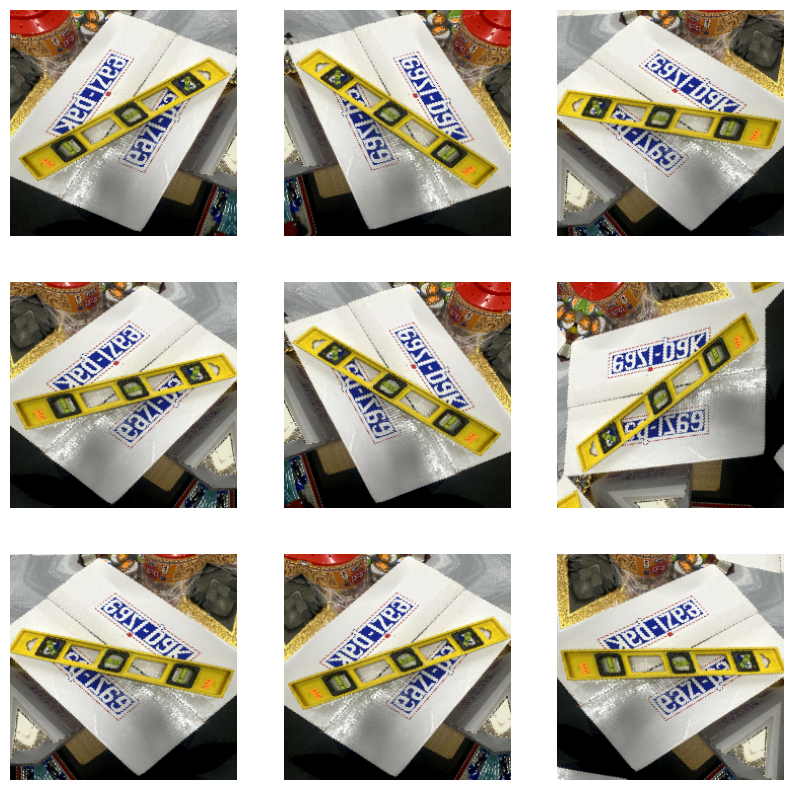

In [15]:
# apply data augumentation
for image, _ in train_dataset_mobilenet.take(1):
    plt.figure(figsize=(10, 10))
    first_image = image[0]
    # Check the range and type of the image data
    print(tf.reduce_min(first_image).numpy(), tf.reduce_max(first_image).numpy())
    print(first_image.dtype)

    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
        # If the images are float32 type, ensure they are between 0 and 1
        augmented_image = tf.squeeze(augmented_image)  # Remove the batch dimension
        # Normalize if the original images are uint8
        if first_image.dtype == tf.uint8:
            plt.imshow(augmented_image.numpy() / 255)
        else:
            plt.imshow(augmented_image.numpy())  # If the images are already between 0 and 1, no need to divide by 255
        plt.axis('off')
    plt.show()

In [16]:
# check the image batch and label batch shape for MobilenetV2
for image_batch_mob, labels_batch_mob in train_dataset_mobilenet:
  print(image_batch_mob.shape)
  print(labels_batch_mob.shape)
  break

(32, 224, 224, 3)
(32, 8)


In [17]:
# download the feature extractor
mobilenet_v2 = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4"

# create the feature extraction layer
mob_feature_extractor_layer = hub.KerasLayer(
    mobilenet_v2,
    input_shape=MOB_INPUT_SHAPE,
    trainable=False)

# eextract the features for image_batch
feature_batch = mob_feature_extractor_layer(image_batch_mob)
print(feature_batch.shape)

(32, 1280)


In [18]:
# add the classification head

model_1 = tf.keras.Sequential([
    data_augmentation,
    mob_feature_extractor_layer,
    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

# Create a dummy batch of data to build the model
dummy_batch = np.random.random((1, 224, 224, 3))
model_1(dummy_batch)

# Display the model's summary
model_1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (1, 224, 224, 3)          0         
                                                                 
 keras_layer (KerasLayer)    (1, 1280)                 2257984   
                                                                 
 dense (Dense)               (1, 8)                    10248     
                                                                 
Total params: 2268232 (8.65 MB)
Trainable params: 10248 (40.03 KB)
Non-trainable params: 2257984 (8.61 MB)
_________________________________________________________________


In [19]:
# compile the model with hyperparameters
base_learning_rate = 0.0001
model_1.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=base_learning_rate),
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# for tensorboard
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(
    log_dir=log_dir,
    histogram_freq=1)

In [20]:
# Start the timer
start_time2 = time.time()

# Training the model
history_1 = model_1.fit(train_dataset_mobilenet,
                    epochs=EPOCHS,
                    validation_data=validation_dataset_mobilenet,
                    callbacks=tensorboard_callback)

# Stop the timer
end_time1 = time.time()

# Calculate the total time taken
total_time1 = end_time1 - start_time2
print(f"Total execution time: {total_time1} seconds")

Epoch 1/50
15/15 [==============================] - 36s 2s/step - loss: 2.2537 - accuracy: 0.1747 - val_loss: 2.1370 - val_accuracy: 0.2243
Epoch 2/50
15/15 [==============================] - 25s 1s/step - loss: 2.0494 - accuracy: 0.2084 - val_loss: 2.0650 - val_accuracy: 0.2243
Epoch 3/50
15/15 [==============================] - 24s 1s/step - loss: 1.9131 - accuracy: 0.2526 - val_loss: 1.8354 - val_accuracy: 0.3271
Epoch 4/50
15/15 [==============================] - 30s 1s/step - loss: 1.7695 - accuracy: 0.3495 - val_loss: 1.7992 - val_accuracy: 0.3364
Epoch 5/50
15/15 [==============================] - 28s 1s/step - loss: 1.6503 - accuracy: 0.4000 - val_loss: 1.6331 - val_accuracy: 0.4019
Epoch 6/50
15/15 [==============================] - 24s 1s/step - loss: 1.5914 - accuracy: 0.4442 - val_loss: 1.6078 - val_accuracy: 0.3832
Epoch 7/50
15/15 [==============================] - 28s 1s/step - loss: 1.4889 - accuracy: 0.4989 - val_loss: 1.5426 - val_accuracy: 0.4673
Epoch 8/50
15/15 [==

In [21]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [22]:
# Evaluate the model
val_loss_1, val_acc_1 = model_1.evaluate(validation_dataset_mobilenet)
print("Validation loss:{:.2f}".format(val_loss_1))
print("Validation accuracy:{:.2f}".format(val_acc_1))


4/4 [==============================] - 8s 42ms/step - loss: 0.5138 - accuracy: 0.8318
Validation loss:0.51
Validation accuracy:0.83


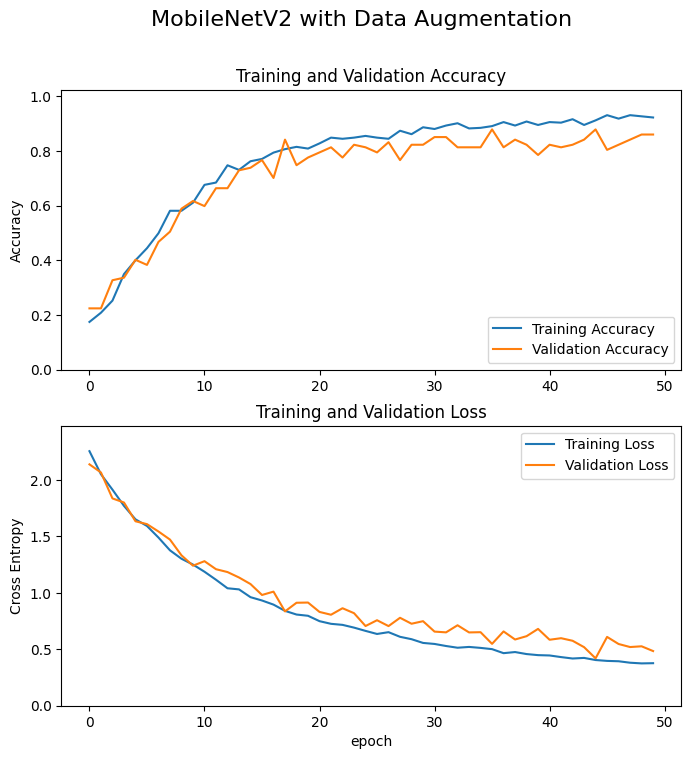

In [23]:

acc_1 = history_1.history['accuracy']
val_acc_1 = history_1.history['val_accuracy']

loss_1 = history_1.history['loss']
val_loss_1 = history_1.history['val_loss']

# plot the graph for training and validation accuracy
plt.figure(figsize=(8, 8))
plt.suptitle('MobileNetV2 with Data Augmentation', fontsize=16)
plt.subplot(2, 1, 1)
plt.plot(acc_1, label='Training Accuracy')
plt.plot(val_acc_1, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([0, max(max(acc_1), max(val_acc_1)) * 1.1])
plt.title('Training and Validation Accuracy')

# plot the graph for training and validation loss
plt.subplot(2, 1, 2)
plt.plot(loss_1, label='Training Loss')
plt.plot(val_loss_1, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0, max(max(loss_1), max(val_loss_1)) * 1.1])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()


## Testing and Evaluation for Model 1 (Using MobileNetV2)

1/1 [==============================] - 0s 33ms/step


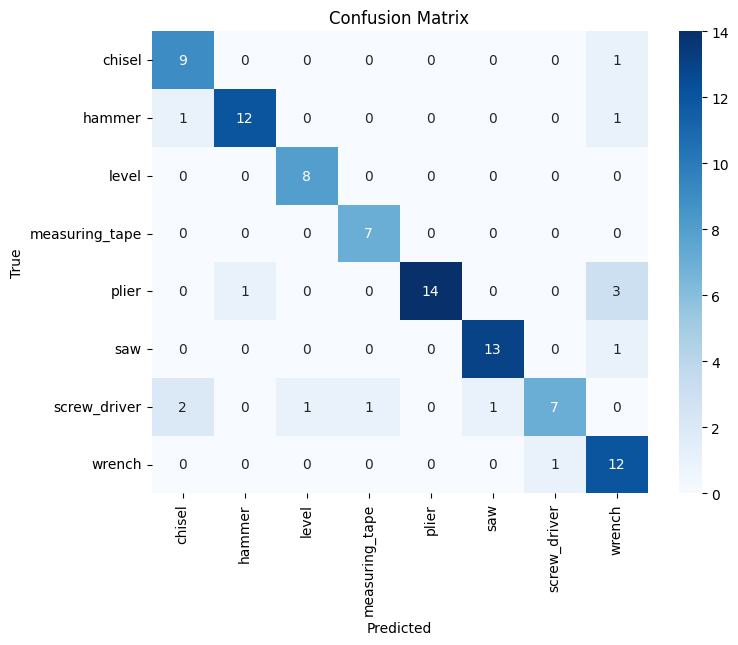

Accuracy: 0.85
Precision: 0.87
Recall: 0.85
F1_score: 0.85

Classification Report MobileNetV2 with Data Augmentation:

                precision    recall  f1-score   support

        chisel       0.75      0.90      0.82        10
        hammer       0.92      0.86      0.89        14
         level       0.89      1.00      0.94         8
measuring_tape       0.88      1.00      0.93         7
         plier       1.00      0.78      0.88        18
           saw       0.93      0.93      0.93        14
  screw_driver       0.88      0.58      0.70        12
        wrench       0.67      0.92      0.77        13

      accuracy                           0.85        96
     macro avg       0.86      0.87      0.86        96
  weighted avg       0.87      0.85      0.85        96



In [24]:
# Initialize arrays to hold the true labels and predicted labels
y_true_1 = []
y_pred_1 = []

# Iterate over the test set
for images, labels in test_dataset_mobilenet:
    preds_1 = model_1.predict(images)
    pred_1_classes = np.argmax(preds_1, axis=1)
    y_true_1.extend(np.argmax(labels.numpy(), axis=1))
    y_pred_1.extend(pred_1_classes)

# Convert lists to numpy arrays for sklearn functions
y_true_1 = np.array(y_true_1)
y_pred_1 = np.array(y_pred_1)

# Calculate the confusion matrix
cm_1 = confusion_matrix(y_true_1, y_pred_1)

# Function to plot confusion matrix
def plot_confusion_matrix(cm_1, class_names):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm_1, annot=True, fmt='g', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Confusion Matrix')
    plt.show()
# Plot the confusion matrix
plot_confusion_matrix(cm_1, class_names)

# Calculate accuracy, precision, recall, and F1 score
accuracy_1 = accuracy_score(y_true_1, y_pred_1)
precision_1 = precision_score(y_true_1, y_pred_1, average='weighted')
recall_1 = recall_score(y_true_1, y_pred_1, average='weighted')
f1_1 = f1_score(y_true_1, y_pred_1, average='weighted')

print(f'Accuracy: {accuracy_1:.2f}')
print(f'Precision: {precision_1:.2f}')
print(f'Recall: {recall_1:.2f}')
print(f'F1_score: {f1_1:.2f}\n')

# Print the classification report
print('Classification Report MobileNetV2 with Data Augmentation:\n')
print(classification_report(y_true_1, y_pred_1, target_names=class_names))


1/1 [==============================] - 0s 32ms/step
['hammer', 'hammer', 'hammer', 'measuring_tape', 'measuring_tape', 'screw_driver', 'saw', 'hammer', 'wrench', 'measuring_tape', 'saw', 'measuring_tape', 'level', 'plier', 'hammer', 'level', 'measuring_tape', 'saw', 'wrench', 'chisel', 'wrench', 'hammer', 'wrench', 'screw_driver', 'level', 'wrench', 'measuring_tape', 'wrench', 'wrench', 'saw', 'saw', 'level']


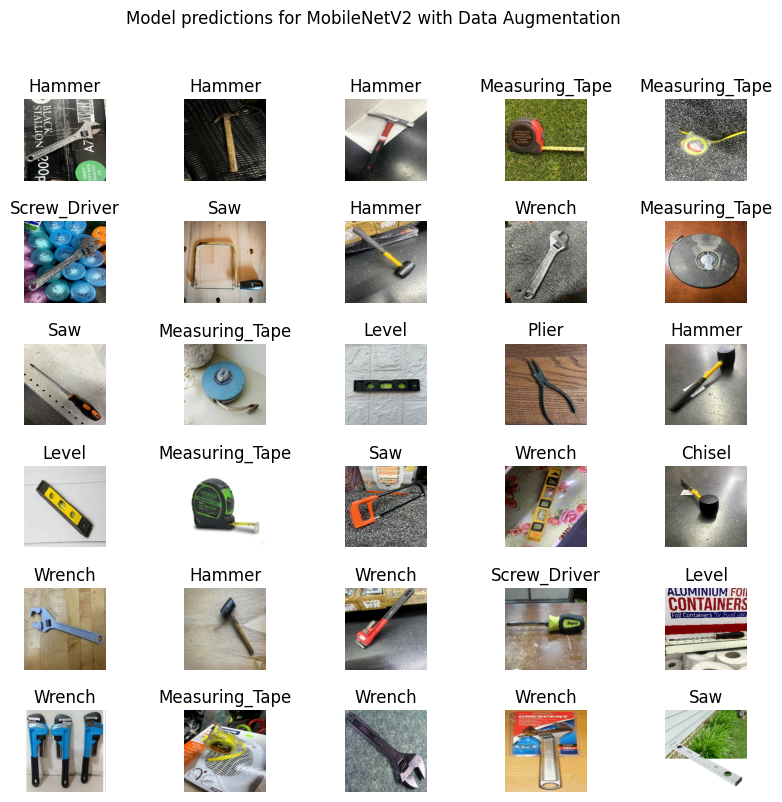

In [25]:
# view the model predictions for MobileNetV2
for image_batch_mob, label_batch_mob in test_dataset_mobilenet:
  pred_1 = model_1.predict(image_batch_mob)
  pred_1_id = tf.math.argmax(pred_1, axis=-1)
  class_names = ['chisel','hammer','level','measuring_tape','plier','saw','screw_driver','wrench']
  label_batch_mob = [class_names[pred_id] for pred_id in pred_1_id.numpy()]
  print(label_batch_mob)
  break

plt.figure(figsize=(10,9))
plt.subplots_adjust(hspace=0.5)
for n in range(30):
  plt.subplot(6,5,n+1)
  plt.imshow(image_batch_mob[n])
  plt.title(label_batch_mob[n].title())
  plt.axis('off')
_ = plt.suptitle("Model predictions for MobileNetV2 with Data Augmentation")

##InceptionV3

In [26]:
# For InceptionV3
INC_IMG_SIZE = (299, 299)  # InceptionV3 expects 299x299 input images
BATCH_SIZE = 32

# Define the image shape with color channels
INC_IMG_SHAPE = INC_IMG_SIZE + (3,)

# Load datasets for InceptionV3 using the image_dataset_from_directory function
train_dataset_inception = tf.keras.utils.image_dataset_from_directory(
    img_data,
    labels='inferred',
    label_mode='categorical',
    validation_split=VAL_SPLIT,
    subset="training",
    seed=SEED,
    image_size=INC_IMG_SIZE,
    batch_size=BATCH_SIZE)

validation_dataset_inception = tf.keras.utils.image_dataset_from_directory(
    img_data,
    labels='inferred',
    label_mode='categorical',
    validation_split=VAL_SPLIT,
    subset="validation",
    seed=SEED,
    image_size=INC_IMG_SIZE,
    batch_size=BATCH_SIZE)

val_batches_inception = tf.data.experimental.cardinality(validation_dataset_inception)
num_test_incep_batches = val_batches_inception // 3 + 1
test_dataset_inception = validation_dataset_inception.take(num_test_incep_batches)
validation_dataset_inception = validation_dataset_inception.skip(num_test_incep_batches)

# Calculate the number of batches in the validation and test datasets for InceptionV3
val_batches_inception = tf.data.experimental.cardinality(validation_dataset_inception)
test_batches_inception = tf.data.experimental.cardinality(test_dataset_inception)

# Calculate the number of images for InceptionV3
val_images_count_inception = val_batches_inception.numpy() * BATCH_SIZE
test_images_count_inception = test_batches_inception.numpy() * BATCH_SIZE

# Handle the last batch being potentially smaller for an exact count
last_val_batch_size_inception = 0
for images, _ in validation_dataset_inception.take(-1):
    last_val_batch_size_inception = images.shape[0]
last_test_batch_size_inception = 0
for images, _ in test_dataset_inception.take(-1):
    last_test_batch_size_inception = images.shape[0]

# If the last batch is smaller, adjust the total image count
if val_batches_inception.numpy() > 0:
    val_images_count_inception = val_images_count_inception - BATCH_SIZE + last_val_batch_size_inception
if test_batches_inception.numpy() > 0:
    test_images_count_inception = test_images_count_inception - BATCH_SIZE + last_test_batch_size_inception

print(f'Number of validation images for InceptionV3: {val_images_count_inception}')
print(f'Number of test images for InceptionV3: {test_images_count_inception}')

normalization_layer_mb = tf.keras.layers.Rescaling(1./255)
train_dataset_inception = train_dataset_inception.map(lambda x, y: (normalization_layer_mb(x), y)) # Where x—images, y—labels.
validation_dataset_inception = validation_dataset_inception.map(lambda x, y: (normalization_layer_mb(x), y)) # Where x—images, y—labels.
test_dataset_inception = test_dataset_inception.map(lambda x, y: (normalization_layer_mb(x), y)) # Where x—images, y—labels.

AUTOTUNE = tf.data.AUTOTUNE

# Prefetch the datasets for InceptionV3
train_dataset_inception = train_dataset_inception.prefetch(buffer_size=AUTOTUNE)
validation_dataset_inception = validation_dataset_inception.prefetch(buffer_size=AUTOTUNE)
test_dataset_inception = test_dataset_inception.prefetch(buffer_size=AUTOTUNE)

# Create a data augmentation layer for InceptionV3
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.experimental.preprocessing.RandomFlip('horizontal'),
  tf.keras.layers.experimental.preprocessing.RandomRotation(0.2)

])

Found 678 files belonging to 8 classes.
Using 475 files for training.
Found 678 files belonging to 8 classes.
Using 203 files for validation.
Number of validation images for InceptionV3: 107
Number of test images for InceptionV3: 96


In [27]:
# check the image batch and label batch shape for InceptionV3
for image_batch_incep, labels_batch_incep in train_dataset_inception:
  print(image_batch_incep.shape)
  print(labels_batch_incep.shape)
  break

(32, 299, 299, 3)
(32, 8)


In [28]:
# download the feature extractor
inception_v3 = "https://tfhub.dev/google/tf2-preview/inception_v3/feature_vector/4"

# create the feature extraction layer
incp_feature_extractor_layer = hub.KerasLayer(
    inception_v3,
    input_shape=INC_IMG_SHAPE,
    trainable=False)

# eextract the features for image_batch
incp_feature_batch = incp_feature_extractor_layer(image_batch_incep)
print(incp_feature_batch.shape)

(32, 2048)


In [29]:
# add the classification head

model_2 = tf.keras.Sequential([
    data_augmentation,
    incp_feature_extractor_layer,
    tf.keras.layers.Dense(NUM_CLASSES, activation='softmax')
])

# Create a dummy batch of data to build the model
icp_dummy_batch = np.random.random((1, *INC_IMG_SHAPE)).astype(np.float32)
model_2(icp_dummy_batch)

# Display the model's summary
model_2.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_2 (Sequential)   (1, 299, 299, 3)          0         
                                                                 
 keras_layer_1 (KerasLayer)  (1, 2048)                 21802784  
                                                                 
 dense_1 (Dense)             (1, 8)                    16392     
                                                                 
Total params: 21819176 (83.23 MB)
Trainable params: 16392 (64.03 KB)
Non-trainable params: 21802784 (83.17 MB)
_________________________________________________________________


In [30]:
# compile the model with hyperparameters
base_learning_rate = 0.0001
model_2.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=base_learning_rate),
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

# for tensorboard
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(
    log_dir=log_dir,
    histogram_freq=1)

In [31]:
# Start the timer
start_time3 = time.time()

history_2 = model_2.fit(train_dataset_inception,
                    epochs=EPOCHS,
                    validation_data=validation_dataset_inception,
                    callbacks=tensorboard_callback)

# Stop the timer
end_time2 = time.time()

# Calculate the total time taken
total_time2 = end_time2 - start_time3
print(f"Total execution time: {total_time2} seconds")

Epoch 1/50
15/15 [==============================] - 45s 2s/step - loss: 2.0717 - accuracy: 0.1684 - val_loss: 1.9812 - val_accuracy: 0.3084
Epoch 2/50
15/15 [==============================] - 33s 2s/step - loss: 1.9172 - accuracy: 0.2842 - val_loss: 1.9491 - val_accuracy: 0.3084
Epoch 3/50
15/15 [==============================] - 32s 2s/step - loss: 1.8223 - accuracy: 0.3200 - val_loss: 1.8199 - val_accuracy: 0.3738
Epoch 4/50
15/15 [==============================] - 33s 2s/step - loss: 1.7194 - accuracy: 0.4526 - val_loss: 1.6795 - val_accuracy: 0.5234
Epoch 5/50
15/15 [==============================] - 33s 2s/step - loss: 1.6277 - accuracy: 0.5095 - val_loss: 1.6630 - val_accuracy: 0.5607
Epoch 6/50
15/15 [==============================] - 30s 1s/step - loss: 1.5129 - accuracy: 0.6316 - val_loss: 1.5717 - val_accuracy: 0.5794
Epoch 7/50
15/15 [==============================] - 33s 2s/step - loss: 1.4207 - accuracy: 0.6674 - val_loss: 1.4725 - val_accuracy: 0.6449
Epoch 8/50
15/15 [==

In [32]:
%tensorboard --logdir logs/fit

Reusing TensorBoard on port 6006 (pid 38526), started 0:32:47 ago. (Use '!kill 38526' to kill it.)

<IPython.core.display.Javascript object>

In [33]:
# Evaluate the second model
val_loss_2, val_acc_2 = model_2.evaluate(validation_dataset_inception)
print("Validation loss:{:.2f}".format(val_loss_2))
print("Validation accuracy:{:.2f}".format(val_acc_2))


4/4 [==============================] - 6s 104ms/step - loss: 0.4581 - accuracy: 0.9159
Validation loss:0.46
Validation accuracy:0.92


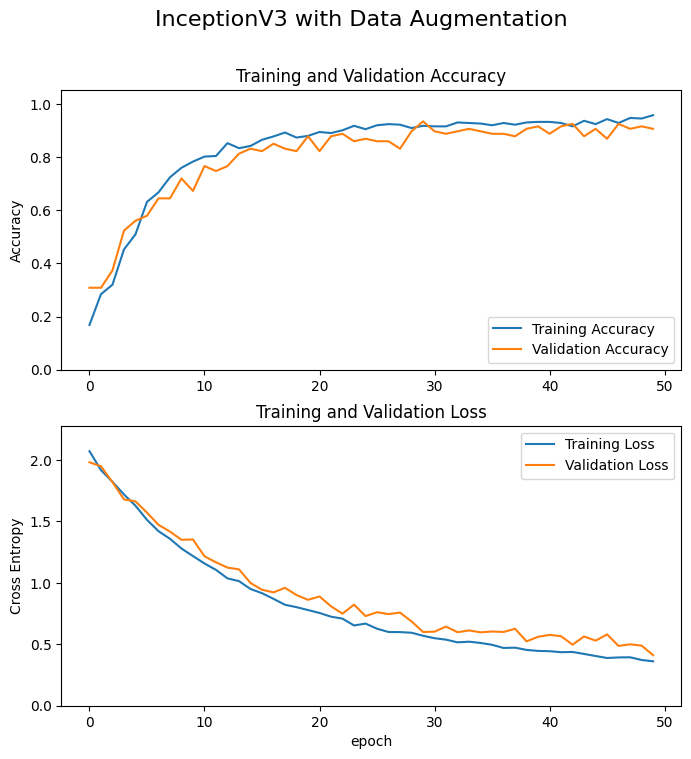

In [34]:
acc_2 = history_2.history['accuracy']
val_acc_2 = history_2.history['val_accuracy']

loss_2 = history_2.history['loss']
val_loss_2 = history_2.history['val_loss']

# plot the graph for training and validation accuracy
plt.figure(figsize=(8, 8))
plt.suptitle('InceptionV3 with Data Augmentation', fontsize=16)
plt.subplot(2, 1, 1)
plt.plot(acc_2, label='Training Accuracy')
plt.plot(val_acc_2, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([0, max(max(acc_2), max(val_acc_2)) * 1.1])
plt.title('Training and Validation Accuracy')

# plot the graph for training and validation loss
plt.subplot(2, 1, 2)
plt.plot(loss_2, label='Training Loss')
plt.plot(val_loss_2, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0, max(max(loss_2), max(val_loss_2)) * 1.1])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()


## Testing and Evaluation for Model 2 (Using InceptionV3)

1/1 [==============================] - 0s 55ms/step


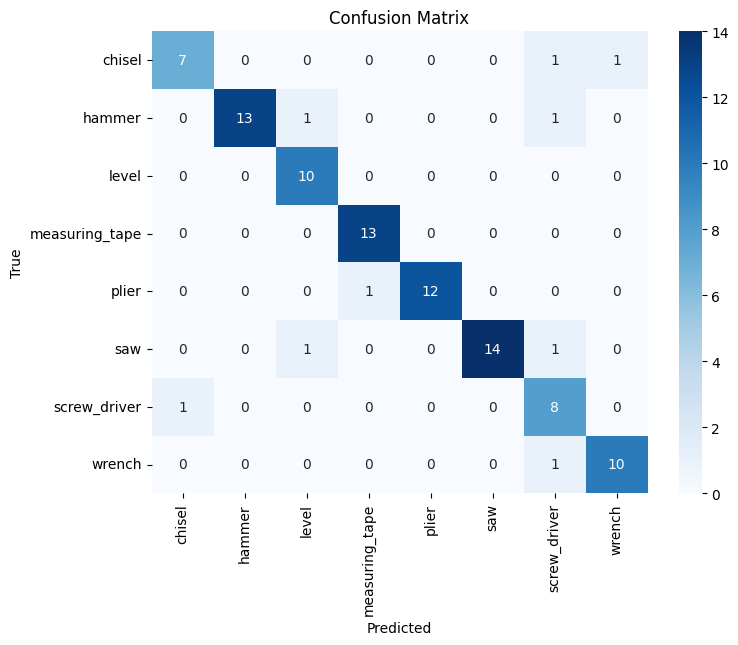

Accuracy: 0.91
Precision: 0.92
Recall: 0.91
F1_score: 0.91

Classification Report for InceptionV3 with Data Augmentation:

                precision    recall  f1-score   support

        chisel       0.88      0.78      0.82         9
        hammer       1.00      0.87      0.93        15
         level       0.83      1.00      0.91        10
measuring_tape       0.93      1.00      0.96        13
         plier       1.00      0.92      0.96        13
           saw       1.00      0.88      0.93        16
  screw_driver       0.67      0.89      0.76         9
        wrench       0.91      0.91      0.91        11

      accuracy                           0.91        96
     macro avg       0.90      0.91      0.90        96
  weighted avg       0.92      0.91      0.91        96



In [35]:
# Initialize arrays to hold the true labels and predicted labels
y_true_2 = []
y_pred_2 = []

# Iterate over the test set
for images, labels in test_dataset_inception:
    preds_2 = model_2.predict(images)
    pred_2_classes = np.argmax(preds_2, axis=1)
    y_true_2.extend(np.argmax(labels.numpy(), axis=1))
    y_pred_2.extend(pred_2_classes)

# Convert lists to numpy arrays for sklearn functions
y_true_2 = np.array(y_true_2)
y_pred_2 = np.array(y_pred_2)

# Calculate the confusion matrix
cm_2 = confusion_matrix(y_true_2, y_pred_2)

# Function to plot confusion matrix
def plot_confusion_matrix(cm_2, class_names):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm_2, annot=True, fmt='g', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Confusion Matrix')
    plt.show()
# Plot the confusion matrix
plot_confusion_matrix(cm_2, class_names)

# Calculate accuracy, precision, recall, and F1 score
accuracy_2 = accuracy_score(y_true_2, y_pred_2)
precision_2 = precision_score(y_true_2, y_pred_2, average='weighted')
recall_2 = recall_score(y_true_2, y_pred_2, average='weighted')
f1_2 = f1_score(y_true_2, y_pred_2, average='weighted')

print(f'Accuracy: {accuracy_2:.2f}')
print(f'Precision: {precision_2:.2f}')
print(f'Recall: {recall_2:.2f}')
print(f'F1_score: {f1_2:.2f}\n')

# Print the classification report
print('Classification Report for InceptionV3 with Data Augmentation:\n')
print(classification_report(y_true_2, y_pred_2, target_names=class_names))


1/1 [==============================] - 0s 57ms/step
['saw', 'wrench', 'measuring_tape', 'measuring_tape', 'measuring_tape', 'screw_driver', 'measuring_tape', 'screw_driver', 'wrench', 'screw_driver', 'level', 'wrench', 'plier', 'wrench', 'screw_driver', 'saw', 'wrench', 'wrench', 'saw', 'wrench', 'screw_driver', 'saw', 'chisel', 'hammer', 'hammer', 'chisel', 'chisel', 'chisel', 'screw_driver', 'hammer', 'level', 'saw']


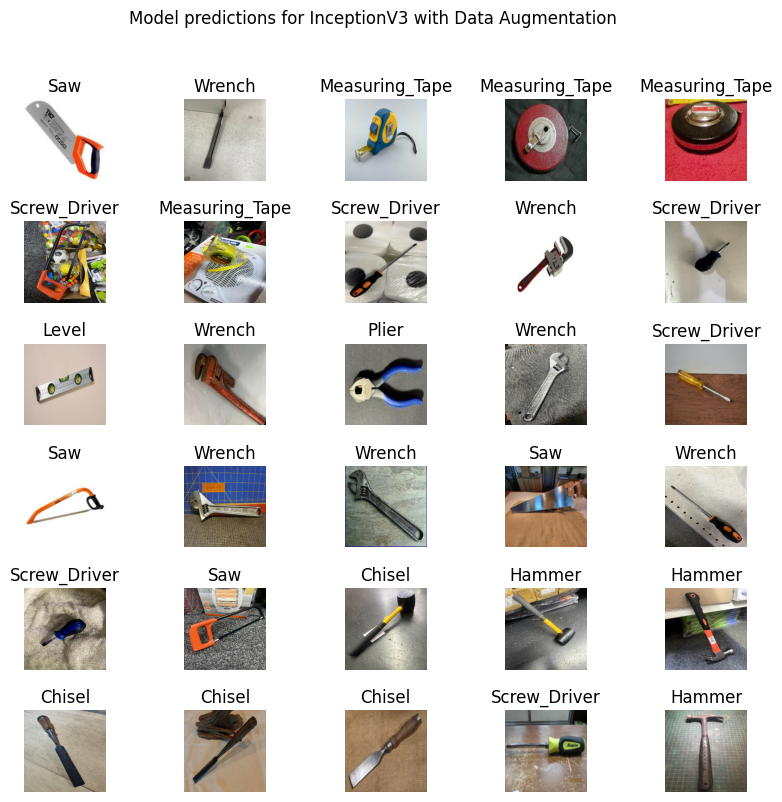

In [36]:
# view the model predictions for InceptionV3
for image_batch_incep, label_batch_incep in test_dataset_inception:
  pred_2 = model_2.predict(image_batch_incep)
  pred_2_id = tf.math.argmax(pred_2, axis=-1)
  label_batch_incep = [class_names[pred_id] for pred_id in pred_2_id.numpy()]
  print(label_batch_incep)
  break

plt.figure(figsize=(10,9))
plt.subplots_adjust(hspace=0.5)
for n in range(30):
  plt.subplot(6,5,n+1)
  plt.imshow(image_batch_incep[n])
  plt.title(label_batch_incep[n].title())
  plt.axis('off')
_ = plt.suptitle("Model predictions for InceptionV3 with Data Augmentation")

In [37]:
# Stop the timer
end_time3 = time.time()

# Calculate the total time taken
total_time3 = end_time3 - start_time1
print(f"Total execution time: {total_time3} seconds")

Total execution time: 3788.561678171158 seconds
